# 1. Load packages

The link to get [ImageAnalysis3](https://github.com/zhengpuas47/ImageAnalysis3) 

or the Zhuang lab archived [source_tools](https://github.com/ZhuangLab/Chromatin_Analysis_2020_cell/tree/master/sequential_tracing/source)

In [2]:
%run "C:\Users\shiwei\Documents\ImageAnalysis3\required_files\Startup_py3.py"
sys.path.append(r"C:\Users\shiwei\Documents")

import ImageAnalysis3 as ia
%matplotlib notebook

from ImageAnalysis3 import *
print(os.getpid())

import h5py
from ImageAnalysis3.classes import _allowed_kwds
import ast

import pandas as pd

12752


See **functions** in the repository for [AnalysisTool_Chromatin](../../functions/README.md)

In [3]:
# Chromatin_analysis_tools (ATC)
# Get path for the py containing functions
import os
import sys
import importlib
module_path =r'C:\Users\shiwei\Documents\AnalysisTool_Chromatin'
if module_path not in sys.path:
    sys.path.append(module_path)
    
# import relevant modules
import gene_selection 
importlib.reload(gene_selection)
import gene_to_loci
importlib.reload(gene_to_loci)
import gene_activity
importlib.reload(gene_activity)
import loci_1d_features
importlib.reload(loci_1d_features)  

import atac_to_loci
importlib.reload(atac_to_loci)

<module 'atac_to_loci' from 'C:\\Users\\shiwei\\Documents\\AnalysisTool_Chromatin\\atac_to_loci.py'>

In [4]:
import seaborn as sns
import scanpy as sc

## 1.1 Define output folder

In [5]:
output_main_folder = r'L:\Shiwei\Figures\MOp_draft_2023_v0\AB_compartment'
output_analysis_folder = os.path.join(output_main_folder, 'analysis')
output_figure_folder = os.path.join(output_main_folder, 'figures')

make_output_folder = True

if make_output_folder and not os.path.exists(output_analysis_folder):
    os.makedirs(output_analysis_folder)
    print(f'Generating analysis folder: {output_analysis_folder}.')
elif os.path.exists(output_analysis_folder):
    print(f'Use existing analysis folder: {output_analysis_folder}.')
    
if make_output_folder and not os.path.exists(output_figure_folder):
    os.makedirs(output_figure_folder)
    print(f'Generating figure folder: {output_figure_folder}.')
elif os.path.exists(output_figure_folder):
    print(f'Use existing figure folder: {output_figure_folder}.')


Use existing analysis folder: L:\Shiwei\Figures\MOp_draft_2023_v0\AB_compartment\analysis.
Use existing figure folder: L:\Shiwei\Figures\MOp_draft_2023_v0\AB_compartment\figures.


## 1.2 setting up plotting parameters

In [6]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
import matplotlib.pyplot as plt
plt.rc('font', family='serif')
plt.rc('font', serif='Arial')

from ImageAnalysis3.figure_tools import _double_col_width, _single_col_width, _font_size, _ticklabel_size,_ticklabel_width

import seaborn as sns
sns.set_context("paper", rc={"font.size":_font_size,"axes.titlesize":_font_size+1,"axes.labelsize":_font_size})  

In [7]:
# cell labels from RNA-MERFISH and celltype prediction
selected_cell_labels = ['L2/3 IT','L4/5 IT','L5 IT','L6 IT','L5 ET','L5/6 NP','L6 CT','L6b',
                           'Sst','Pvalb','Lamp5','Sncg','Vip',
                           'Astro','Oligo','OPC','Micro','Endo','VLMC','SMC','Peri', 
                           #'other',
                          ]
# cell palette from RNA-MERFISH UMAP and stats
celltype_palette = {'Astro':'lightcoral', 
                    'Endo':'skyblue', 
                    'L2/3 IT':'gold', 
                    'L4/5 IT':'darkorange', 
                    'L5 ET':'mediumseagreen', 
                    'L5 IT':'aqua',
                    'L5/6 NP':'darkgreen',
                    'L6 CT':'brown',
                    'L6 IT':'magenta',
                    'L6b':'blue', 
                    'Lamp5':'orange', 
                    'Micro':'peachpuff',
                    'OPC':'thistle', 
                    'Oligo':'darkviolet',
                    'Peri':'sandybrown',
                    'Pvalb':'springgreen',
                    'SMC':'rosybrown',
                    'Sncg':'darkkhaki',
                    'Sst':'steelblue', 
                    'VLMC':'saddlebrown', 
                    'Vip':'red',
                    'other':'slategray'}


In [8]:
# this is the plotting order noted based on the snRNA transcriptional acitivty;
# we'd use this for all the graphs in this notebook
# use the snRNA data below (# section 3.1.1) if needs to re-calculate
sorted_cellplot_order = ['Micro', 'Oligo', 'Endo', 'OPC', 'Astro', 'Vip', 'Lamp5',
                  'L5/6 NP', 'Sst', 'Sncg', 'Pvalb', 'L4/5 IT', 'L6 CT',
                  'L6 IT', 'L6b', 'L2/3 IT', 'L5 IT', 'L5 ET']

# 2. Load codebook

## Codebook

Example of [codebook](../../postanalysis/0_locus_annotation/resources/MERFISH_loci_adjacent_genes_tss_more_res.csv)

In [9]:
# load codebook
# L drive is Crick Pu_SSD_0
codebook_save_folder=r'C:\Users\shiwei\Documents\AnalysisTool_Chromatin\resources'

# Load sorted codebook (allows direct matrix slicing) with cell type info
# Load codebook (then sort to allow direct matrix slicing) with cell type info

codebook_fname = os.path.join(codebook_save_folder,'MERFISH_loci_adjacent_genes_tss_more_res.csv')
codebook_df = pd.read_csv (codebook_fname, index_col=0)

# sort df temporailiy so matrix can be sliced by df order directly
codebook_df = loci_1d_features.sort_loci_df_by_chr_order (codebook_df)

codebook_df.head()

,name,id,chr,chr_order,library,dtype,adjacent_genes_0kb_tss,adjacent_genes_10kb_tss,adjacent_genes_50kb_tss,adjacent_genes_100kb_tss,adjacent_genes_200kb_tss,adjacent_genes_500kb_tss,adjacent_genes_1000kb_tss,adjacent_genes_1500kb_tss,adjacent_genes_2000kb_tss
loci_name,,,,,,,,,,,,,,,
chr1_3742742_3759944,1:3742742-3759944,1,1,0,CTP11,combo,intergenic,intergenic,intergenic,Xkr4,Xkr4,Gm18956; Gm7341; Xkr4,Gm18956; Gm2053; Gm6085; Gm6101; Gm6119; Gm734...,Atp6v1h; Gm16041; Gm17101; Gm18956; Gm2053; Gm...,Atp6v1h; Gm16041; Gm17101; Gm18956; Gm2053; Gm...
chr1_6245958_6258969,1:6245958-6258969,2,1,1,CTP11,combo,intergenic,intergenic,4732440D04Rik; Rb1cc1,4732440D04Rik; Rb1cc1,4732440D04Rik; Gm19026; Gm2147; Rb1cc1,4732440D04Rik; Gm19026; Gm2147; Npbwr1; Rb1cc1...,4732440D04Rik; Gm19026; Gm2147; Gm5694; Gm7182...,4732440D04Rik; Atp6v1h; Gm16041; Gm17101; Gm19...,4732440D04Rik; Atp6v1h; Gm16041; Gm17101; Gm19...
chr1_8740008_8759916,1:8740008-8759916,3,1,2,CTP11,combo,intergenic,intergenic,Gm15452,Gm15452,Gm15452,Gm15452,1700034P13Rik; 2610203C22Rik; Adhfe1; Gm15452;...,1700034P13Rik; 2610203C22Rik; Adhfe1; Arfgef1;...,1700034P13Rik; 2610203C22Rik; Adhfe1; Arfgef1;...
chr1_9627926_9637875,1:9627926-9637875,1,1,3,CTP13,combo,2610203C22Rik,2610203C22Rik,2610203C22Rik,2610203C22Rik; Adhfe1; Gm6161; Mybl1; Rrs1,1700034P13Rik; 2610203C22Rik; Adhfe1; Gm18300;...,1700034P13Rik; 2610203C22Rik; Adhfe1; Cops5; C...,1700034P13Rik; 2610203C22Rik; Adhfe1; Arfgef1;...,1700034P13Rik; 2610203C22Rik; Adhfe1; Arfgef1;...,1700034P13Rik; 2610203C22Rik; A830018L16Rik; A...
chr1_9799472_9811359,1:9799472-9811359,2,1,4,CTP13,combo,Gm6195,Gm6195; Sgk3,Gm6195; Sgk3,1700034P13Rik; Gm6195; Mcmdc2; Mybl1; Sgk3; Vc...,1700034P13Rik; 2610203C22Rik; Gm6195; Mcmdc2; ...,1700034P13Rik; 2610203C22Rik; Adhfe1; Arfgef1;...,1700034P13Rik; 2610203C22Rik; Adhfe1; Arfgef1;...,1700034P13Rik; 2610203C22Rik; Adhfe1; Arfgef1;...,1700034P13Rik; 2610203C22Rik; A830018L16Rik; A...


## Refgen for gene dist matrix

Example of [refgen](../0_locus_annotation/resources/refgen_df_for_jie.csv)

In [10]:
codebook_folder = r'\\10.245.74.158\Chromatin_NAS_8\Analyzed_data\MouseBrain_PostAnalysis'
df_refgen_savename = os.path.join(codebook_folder,'refgen_df_for_jie.csv')
df_refgen=pd.read_csv(df_refgen_savename,index_col=0)
df_refgen['chr'] = df_refgen['chr'].apply(lambda x: 'chr'+x)
df_refgen.head()

,name,id,chr,chr_order,library,dtype,loci_name,start,end,hyb,delta,region_id
0,1:3742742-3759944,1,chr1,0,CTP11,combo,chr1_3742742_3759944,3742742,3759944,0,0,1
1,1:6245958-6258969,2,chr1,1,CTP11,combo,chr1_6245958_6258969,6245958,6258969,1,2503216,2
2,1:8740008-8759916,3,chr1,2,CTP11,combo,chr1_8740008_8759916,8740008,8759916,2,4997266,3
3,1:9627926-9637875,1,chr1,3,CTP13,combo,chr1_9627926_9637875,9627926,9637875,3,5885184,4
4,1:9799472-9811359,2,chr1,4,CTP13,combo,chr1_9799472_9811359,9799472,9811359,4,6056730,5


In [11]:
chrom_number = []
for i, row in df_refgen.iterrows():
    if ('X' in row.chr):
        chrom_number.append(20)
    elif ('Y' in row.chr):
        chrom_number.append(21)
    else:
        chrom_number.append(int(row['chr'].split('chr')[-1]))
df_refgen['chrom_number'] = chrom_number
df_refgen.sort_values(['chrom_number','hyb'], inplace=True, ignore_index=True)
df_refgen.head()

,name,id,chr,chr_order,library,dtype,loci_name,start,end,hyb,delta,region_id,chrom_number
0,1:3742742-3759944,1,chr1,0,CTP11,combo,chr1_3742742_3759944,3742742,3759944,0,0,1,1
1,1:6245958-6258969,2,chr1,1,CTP11,combo,chr1_6245958_6258969,6245958,6258969,1,2503216,2,1
2,1:8740008-8759916,3,chr1,2,CTP11,combo,chr1_8740008_8759916,8740008,8759916,2,4997266,3,1
3,1:9627926-9637875,1,chr1,3,CTP13,combo,chr1_9627926_9637875,9627926,9637875,3,5885184,4,1
4,1:9799472-9811359,2,chr1,4,CTP13,combo,chr1_9799472_9811359,9799472,9811359,4,6056730,5,1


In [12]:
from scipy.spatial.distance import squareform, pdist
chr_gene_dist_matrices = {}
for chrom, df_chr in df_refgen.groupby('chr'):
    if 'Y' not in chrom:
        _df = df_chr.sort_values('hyb')
        _delta_values= np.zeros((len(_df),2))
        _delta_values[:,0] = _df.delta.values
        _gene_dist = squareform(pdist(_delta_values))
        chr_gene_dist_matrices[chrom] = _gene_dist

# 3. Load contact dict

Data below can be generated from the notebook:

[preprocess/2_dna_merfish/scripts/2_spot_pick/5_summarize_jie_to_dict_contact750](../../preprocess/2_dna_merfish/scripts/2_spot_pick/5_summarize_jie_to_dict_contact750.ipynb)

In [28]:
postanalysis_folder_CW = r'\\10.245.74.158\Chromatin_NAS_8\Analyzed_data\MouseBrain_PostAnalysis_0312'

class_2_contact_filename = os.path.join(postanalysis_folder_CW, 'class_2_contactDict_750.pkl')
print(class_2_contact_filename)
if os.path.exists(class_2_contact_filename):
    print("Loading contact")
    class_2_contactDict = np.load(class_2_contact_filename, allow_pickle=True)

\\10.245.74.158\Chromatin_NAS_8\Analyzed_data\MouseBrain_PostAnalysis_0312\class_2_contactDict_750.pkl
Loading contact


# 4. Load snATAC for correlation

Data be can be generated from the notebook:

[0_locus_annotation/scripts/3_sn_atac_mop_process_all_merfish_loci_4Mb](../0_locus_annotation/scripts/3_sn_atac_mop_process_all_merfish_loci_4Mb.ipynb)

In [29]:
import tqdm

rna_folder = r'F:\Chromatin_v3r_result\Gene_expression\10x_snATAC\10x_class'
#rna_folder = r'F:\Chromatin_v3r_result\Gene_expression\10x_snRNA\10x_class'

rna_df_dict = {}

#sel_class_list =class_2_contactDict.keys()

#bin_size = 500
bin_size = 2000
sel_class_list = ['Gluta','GABA','Oligo','Astro','Endo','Micro']
for _class in tqdm.tqdm(sel_class_list):
#for _class in tqdm.tqdm(['Astro','Oligo','GLuta']):
    _class_name = _class.replace(' ','_').replace('/','_')
    #print(_class_name)
    rna_fname = os.path.join(rna_folder,f'MERFISH_loci_10x_expression_2X_{bin_size}kb_for_{_class_name}.csv')
    if os.path.exists(rna_fname):
        rna_df = pd.read_csv(rna_fname,index_col=0)
        #rna_df = pd.read_csv(os.path.join(rna_folder,r'Astro_genome_Adjacent_1Mb.csv'),index_col=0)

        rna_df['mean_rna'] = rna_df.mean(axis=1)
        rna_df['median_rna'] = rna_df.median(axis=1)
        rna_df['log10p_mean_rna'] = np.log10(rna_df['mean_rna']+1)
        rna_df['log10p_median_rna'] = np.log10(rna_df['median_rna']+1)
        rna_df_dict[_class] = rna_df

100%|████████████████████████████████████████████████████████████████████████████████████| 6/6 [02:00<00:00, 20.04s/it]


# 5. Generate ploymer model based on genomic distances

In [15]:
# define function for gaussian distribution
def polymer_chain_model(r, s_2):
    return np.power(np.pi*s_2, -1/2)*np.power(np.e, -r**2/s_2)

# import integrate library
from scipy.integrate import quad

In [16]:
# calculate the s^2 (sigma square) for the distribution
# s^2 = 2/3*n*b^2 = 2/3*lp*L*tau^2
chr_prob_matrices = {}

lp = 40*1e-3
tau = 0.3*1e-3 # (in um)

for (chrom, gene_dist) in chr_gene_dist_matrices.items():
    s_2 = 2/3*lp*gene_dist*tau
    _integrate = np.ones(s_2.shape)
    for i in range(_integrate.shape[0]):
        for j in range(_integrate.shape[1]):
            if i!=j:
                _integrate[i,j], _ = quad(polymer_chain_model, -0.75, 0.75, args=s_2[i,j])
    chr_prob_matrices[chrom] = _integrate

# 6. Compartment correlation map and pca analysis

In [18]:
# Chromatin_analysis_tools (ATC)
# Get path for the py containing functions
import os
import sys
import importlib
module_path =r'C:\Users\shiwei\Documents\AnalysisTool_Chromatin'
if module_path not in sys.path:
    sys.path.append(module_path)
    
# import relevant modules
import gene_selection 
importlib.reload(gene_selection)
import gene_to_loci
importlib.reload(gene_to_loci)
import gene_activity
importlib.reload(gene_activity)
import loci_1d_features
importlib.reload(loci_1d_features)

import AB_calling_CW
import matrix_plot_CW

In [52]:
from importlib import reload
reload(AB_calling_CW)

<module 'AB_calling_CW' from 'C:\\Users\\shiwei\\Documents\\AnalysisTool_Chromatin\\AB_calling_CW.py'>

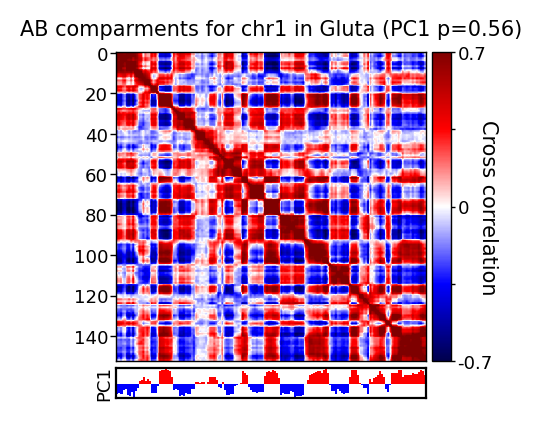

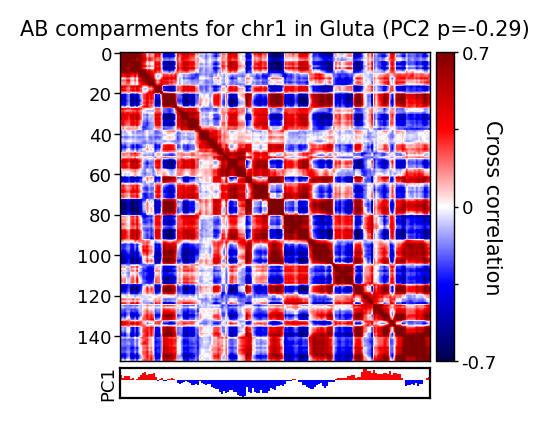

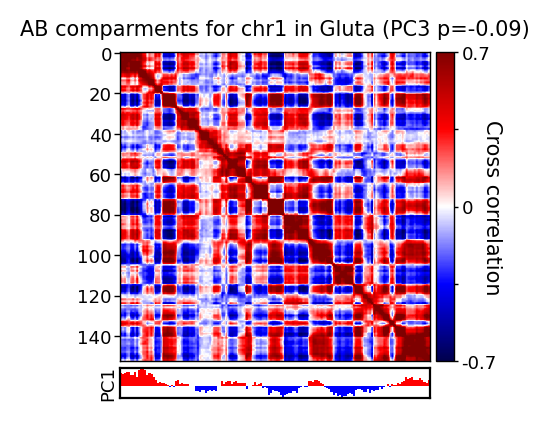

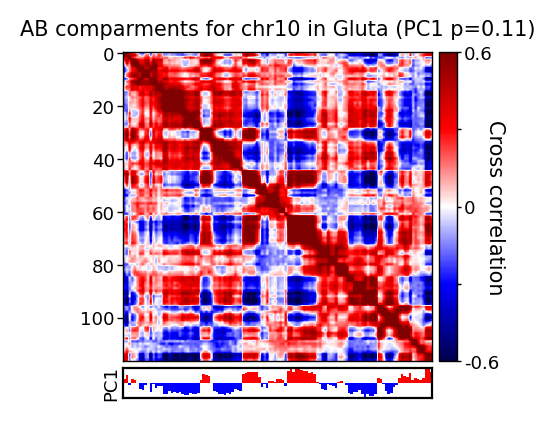

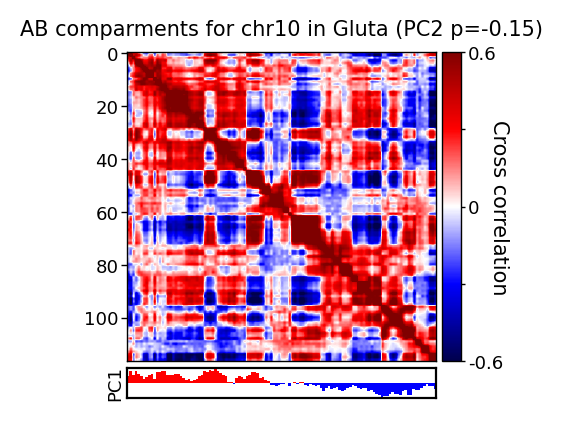

...

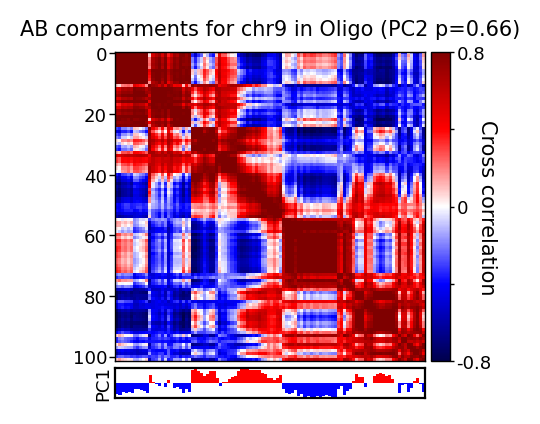

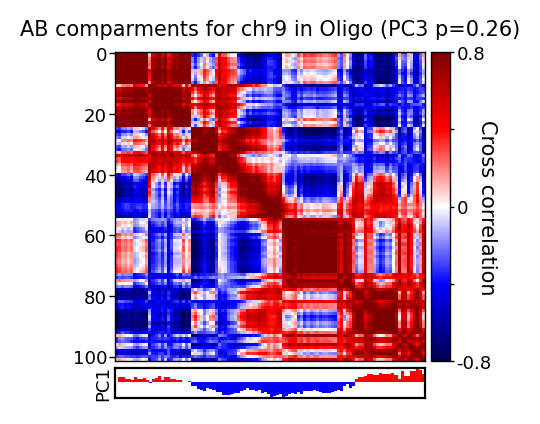

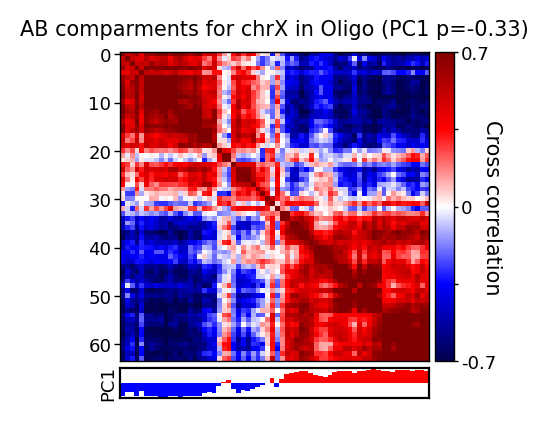

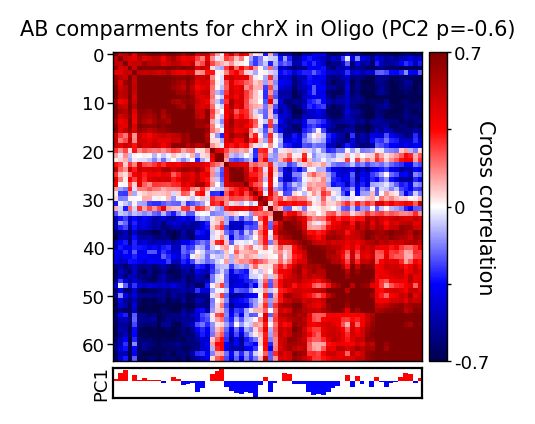

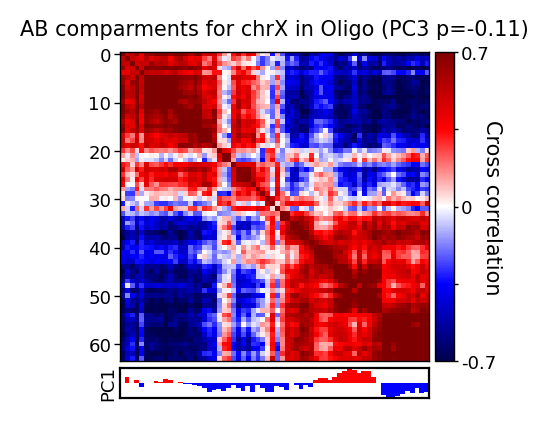

In [63]:
%matplotlib inline

#plt.style.use('dark_background')
plt.style.use('default')
dict_pca_result = {}

for (cls, contact_map_by_cls) in contact_maps.items(): 
    for (key, contact_map) in contact_map_by_cls.items():
        if ('cis_' in key) & ('Y' not in key):
            chrom = 'chr' + key.split('cis_')[-1]
            # get celltype ref modality
            rna_df = rna_df_dict[cls]
            #ref_modality_chr_group = np.array(rna_df[rna_df.index.str.contains(f'{chrom}_')]['log10p_mean_rna'].tolist())
            ref_modality_chr_group = np.array(rna_df[rna_df.index.str.contains(f'{chrom}_')]['mean_rna'].tolist())
            dict_pca_result[(cls, chrom)] = AB_calling_CW.call_AB_compartments_v3(contact_map, 
                                                                                chr_prob_matrices[chrom], ref_modality_chr_group,  
                                                                                cls, chrom, 
                                                                                save_fig=True, 
                                                                                figure_folder=os.path.join(output_analysis_folder,'compartment_majorType'), )

# 7. Save

In [64]:
import pickle
dict_pca_fname = os.path.join(output_analysis_folder,'majorType_pca_analysis_result.pkl')
pickle.dump(dict_pca_result, open(dict_pca_fname,'wb'))

# 8. Plot

In [65]:
import pickle
dict_pca_fname = os.path.join(output_analysis_folder,'majorType_pca_analysis_result.pkl')
dict_pca_result = pickle.load(open(dict_pca_fname,'rb'))

In [69]:
sel_pca_res

{'celltype': 'Gluta',
 'chrom': 'chr1',
 'norm_pc1': array([-1.07203609, -1.0057865 , -1.07295569, -0.71160313, -0.56078893,
        -1.20019795, -1.30351188, -0.95640265, -1.4035559 , -0.76846802,
        -0.42852575,  0.27612632,  0.38293911,  0.70230138,  0.35216583,
         0.49370576,  0.2762121 , -1.06844132, -1.02531908, -1.05196683,
        -0.19877988,  1.45075611,  1.49613799,  1.56008589,  1.59000626,
         1.55362601,  1.3823668 ,  0.76065623, -0.65831092, -0.6049785 ,
        -0.71239593, -1.31564811, -1.23153916, -1.32242461, -1.03889474,
        -1.15735763, -1.1022277 , -0.57858795, -0.60094434,  0.19908554,
         0.22335434,  0.09491431,  0.22603508,  0.14517279,  0.01329054,
         0.18573495,  0.76336338,  0.79688806,  0.73142484,  0.40147825,
        -0.32789157, -0.44714245,  0.23753999, -0.67369873, -1.26413678,
        -1.18128881, -1.07011547, -1.07406074, -0.22555526, -0.08356234,
         0.02032742,  0.09141757,  1.46211515,  1.17468256,  0.9457725 ,

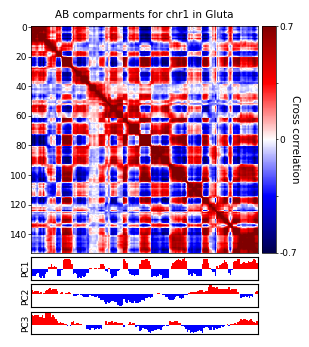

In [76]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

chrom = 'chr1'
cell_type = 'Gluta'

sel_pca_res = dict_pca_result[(cell_type, chrom)]



correlation_map = sel_pca_res['correlation_map']
figure_file = os.path.join(output_figure_folder,f'{cell_type}_{chrom}_ABcompartment.pdf')


save_fig = False

fig, ax1 = plt.subplots(figsize=(4,4), dpi=100)
# create a color map
current_cmap = cm.get_cmap('seismic').copy()
current_cmap.set_bad(color=[0.5,0.5,0.5,1])
upper_indices = np.triu_indices(len(correlation_map),k=1)
all_corr = correlation_map[upper_indices]
bound = round(np.max([abs(np.percentile(all_corr,95)), abs(np.percentile(all_corr,5))]),1)
vmin = -bound
vmax = bound
_pf = ax1.imshow(correlation_map, 
                 cmap=current_cmap, vmin=vmin, vmax=vmax)

ax1.xaxis.set_tick_params(which='both', labelbottom=True)
ax1.yaxis.set_tick_params(which='both', labelleft=True)
ax1.set_title(f"AB comparments for {chrom} in {cell_type}", fontsize=_font_size)
ax1.tick_params('both', labelsize=_font_size-1, 
                width=_ticklabel_width, length=_ticklabel_size,
                pad=1, labelleft=True, labelbottom=False) # remove bottom ticklabels for ax1
[i[1].set_linewidth(_ticklabel_width) for i in ax1.spines.items()]
# locate ax1
divider = make_axes_locatable(ax1)
# colorbar ax
cax = divider.append_axes('right', size='6%', pad="2%")
cbar = plt.colorbar(_pf,cax=cax, ax=ax1, ticks=[vmin, vmin/2, 0.0, vmax/2, vmax])
cbar.ax.set_yticklabels([str(vmin), '', '0', '', str(vmax)])
cbar.ax.tick_params('both', labelsize=_font_size-1, 
                width=_ticklabel_width, length=_ticklabel_size-0.5,
                pad=1, labelleft=False) # remove bottom ticklabels for ax1
[i[1].set_linewidth(_ticklabel_width) for i in cbar.ax.spines.items()]
#cbar.set_ticks([vmin,vmax])
cbar.outline.set_linewidth(_ticklabel_width)
cbar.set_label('Cross correlation', 
               fontsize=_font_size, labelpad=2, rotation=270)
cbar.ax.minorticks_off()

# create bottom ax in order
for _pc_name_idx, _pc_name in enumerate(['norm_pc1','norm_pc2','norm_pc3']):
    norm_pc1 = sel_pca_res[_pc_name]

    bot_ax = divider.append_axes('bottom', size='10%', pad="2%", 
                                 sharex=ax1, xticks=[])
    bot_ax.bar(np.where(norm_pc1>0)[0], norm_pc1[norm_pc1>0], color='r', width=1, bottom=0)
    bot_ax.bar(np.where(norm_pc1<=0)[0], norm_pc1[norm_pc1<=0],color='b', width=1, bottom=0)

    bot_ax.tick_params('x', labelsize=_font_size-1, 
                    width=_ticklabel_width, length=_ticklabel_size,
                    pad=1, labelleft=False, labelbottom=True) # remove bottom ticklabels for ax1
    bot_ax.tick_params('y', labelsize=_font_size-1, 
                    width=_ticklabel_width, length=0,
                    pad=1, labelleft=False, labelbottom=True) # remove bottom ticklabels for ax1
    bot_ax.set_ylabel(f'PC{_pc_name_idx+1}', fontsize=_font_size-1, labelpad=1)



# save
if save_fig:
    plt.savefig(figure_file,
                transparent=True, bbox_inches='tight', pad_inches=0.2, dpi=300)
    plt.savefig(figure_file.replace('.pdf', '.png'),
                transparent=True, bbox_inches='tight', pad_inches=0.2, dpi=300)

plt.show()